# Text Analysis

## Import libraries

In [6]:
# Basic imports
from datetime import datetime

from collections import Counter

# Text analysis importsimport numpy as np
import pandas as pd
from os import path
from PIL import Image
from scripts.text_analysis import wordcloud

import matplotlib.pyplot as plt
% matplotlib inline



UsageError: Line magic function `%` not found.


The Standard Python tool for natural language processing (NLP), tokenization etc. is NLTK.
In our projekt we will use spaCy, because it offers a more modern architecture and mor pre-trained language models.
Therefor install following:

### pip install -U pip setuptools wheel
### pip install -U spacy
### python -m spacy download en_core_web_sm

## Import data

In [7]:
dataset = pd.read_csv('data/cleaned_train_v2.csv', index_col=[0])

C:\Users\dpedwards\AppData\Local\Programs\Python\Python38\lib\site-packages\IPython\core\interactiveshell.py:3145: DtypeWarning: Columns (3) have mixed types.Specify dtype option on import or set low_memory=False.
  has_raised = await self.run_ast_nodes(code_ast.body, cell_name,
C:\Users\dpedwards\AppData\Local\Programs\Python\Python38\lib\site-packages\numpy\lib\arraysetops.py:580: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask |= (ar1 == a)


In [8]:
dataset.head()

,channelGrouping,date,fullVisitorId,visitId,visitNumber,visitStartTime,device.browser,device.isMobile,device.operatingSystem,geoNetwork.country,...,totals.newVisits,totals.pageviews,totals.transactionRevenue,trafficSource.adContent,trafficSource.campaign,trafficSource.isTrueDirect,trafficSource.keyword,trafficSource.medium,trafficSource.referralPath,trafficSource.source
0,Organic Search,20171016,3162355547410993243,1508198450,1,1508198450,Firefox,0,Windows,Germany,...,1.0,1.0,0.0,None,(not set),False,water bottle,organic,(not provided),google
1,Referral,20171016,8934116514970143966,1508176307,6,1508176307,Chrome,0,Chrome OS,United States,...,0.0,2.0,0.0,None,(not set),False,(not provided),referral,/a/google.com/transportation/mtv-services/bike...,sites.google.com
2,Direct,20171016,7992466427990357681,1508201613,1,1508201613,Chrome,1,Android,United States,...,1.0,2.0,0.0,None,(not set),True,(not provided),(none),(not provided),(direct)
3,Organic Search,20171016,9075655783635761930,1508169851,1,1508169851,Chrome,0,Windows,Turkey,...,1.0,2.0,0.0,None,(not set),False,(not provided),organic,(not provided),google
4,Organic Search,20171016,6960673291025684308,1508190552,1,1508190552,Chrome,0,Windows,Mexico,...,1.0,2.0,0.0,None,(not set),False,(not provided),organic,(not provided),google


# Text EDA

## Preparation

In [9]:
# We are only interested in this columns:
dataset = dataset[['channelGrouping', 'device.browser', 'device.operatingSystem', 'geoNetwork.country', 'trafficSource.keyword', 'trafficSource.medium', 'trafficSource.source']]
dataset.head(100)

,channelGrouping,device.browser,device.operatingSystem,geoNetwork.country,trafficSource.keyword,trafficSource.medium,trafficSource.source
0,Organic Search,Firefox,Windows,Germany,water bottle,organic,google
1,Referral,Chrome,Chrome OS,United States,(not provided),referral,sites.google.com
2,Direct,Chrome,Android,United States,(not provided),(none),(direct)
3,Organic Search,Chrome,Windows,Turkey,(not provided),organic,google
4,Organic Search,Chrome,Windows,Mexico,(not provided),organic,google
...,...,...,...,...,...,...,...
95,Paid Search,Safari,Macintosh,United States,6qEhsCssdK0z36ri,cpc,google
96,Direct,Chrome,Android,United States,(not provided),(none),(direct)
97,Paid Search,Chrome,Android,United States,6qEhsCssdK0z36ri,cpc,google
98,Paid Search,Safari,iOS,United States,6qEhsCssdK0z36ri,cpc,google


In [10]:
print("There are {} observations and {} features in this dataset. \n".format(dataset.shape[0],dataset.shape[1]))

# Channel grouping
print("There are {} types of channel grouping in this dataset such as {}... \n".format(len(dataset['channelGrouping'].unique()),
                                                                           ", ".join(dataset['channelGrouping'].unique()[0:5])))

# Browser
print("There are {} types of browsers in this dataset such as {}... \n".format(len(dataset['device.browser'].unique()),
                                                                           ", ".join(dataset['device.browser'].unique()[0:5])))

# Operating system
print("There are {} operating systems in this dataset such as {}... \n".format(len(Counter(dataset['device.operatingSystem']).keys()),
                                                                                      ", ".join(dataset['device.operatingSystem'].unique()[0:5])))

# Country
print("There are {} countries in this dataset such as {}... \n".format(len(dataset['geoNetwork.country'].unique()),
                                                                                      ", ".join(dataset['geoNetwork.country'].unique()[0:5])))

# Keyword
print("There are {} keywords in this dataset such as {}... \n".format(len(dataset['trafficSource.keyword'].unique()),
                                                                                      ", ".join(dataset['trafficSource.keyword'].unique()[0:5])))

# Medium
print("There are {} medium in this dataset such as {}... \n".format(len(dataset['trafficSource.medium'].unique()),
                                                                                      ", ".join(dataset['trafficSource.medium'].unique()[0:5])))

# Source
print("There are {} sources in this dataset such as {}... \n".format(len(dataset['trafficSource.source'].unique()),
                                                                                      ", ".join(dataset['trafficSource.source'].unique()[0:5])))

There are 1708337 observations and 7 features in this dataset. 

There are 8 types of channel grouping in this dataset such as Organic Search, Referral, Direct, Paid Search, Display... 

There are 129 types of browsers in this dataset such as Firefox, Chrome, Safari, UC Browser, Internet Explorer... 

There are 24 operating systems in this dataset such as Windows, Chrome OS, Android, Macintosh, iOS... 

There are 228 countries in this dataset such as Germany, United States, Turkey, Mexico, United Kingdom... 

There are 4546 keywords in this dataset such as water bottle, (not provided), (Remarketing/Content targeting), 6qEhsCssdK0z36ri, (automatic matching)... 

There are 7 medium in this dataset such as organic, referral, (none), cpc, affiliate... 

There are 345 sources in this dataset such as google, sites.google.com, (direct), analytics.google.com, blog.golang.org... 



In [11]:
dataset[["channelGrouping", "device.browser","device.operatingSystem", "geoNetwork.country", "trafficSource.keyword", "trafficSource.medium", "trafficSource.source"]].head(100)

,channelGrouping,device.browser,device.operatingSystem,geoNetwork.country,trafficSource.keyword,trafficSource.medium,trafficSource.source
0,Organic Search,Firefox,Windows,Germany,water bottle,organic,google
1,Referral,Chrome,Chrome OS,United States,(not provided),referral,sites.google.com
2,Direct,Chrome,Android,United States,(not provided),(none),(direct)
3,Organic Search,Chrome,Windows,Turkey,(not provided),organic,google
4,Organic Search,Chrome,Windows,Mexico,(not provided),organic,google
...,...,...,...,...,...,...,...
95,Paid Search,Safari,Macintosh,United States,6qEhsCssdK0z36ri,cpc,google
96,Direct,Chrome,Android,United States,(not provided),(none),(direct)
97,Paid Search,Chrome,Android,United States,6qEhsCssdK0z36ri,cpc,google
98,Paid Search,Safari,iOS,United States,6qEhsCssdK0z36ri,cpc,google


In [12]:
# Groupby by country
country = dataset.groupby("geoNetwork.country")

# Summary statistic of all countries
country.describe().head()

channelGrouping                               \
                             count unique             top  freq   
geoNetwork.country                                                
(not set)                     2517      7  Organic Search   927   
Afghanistan                    133      6  Organic Search    53   
Albania                        768      7          Social   530   
Algeria                       3204      7          Social  2564   
American Samoa                   2      1          Social     2   

                   device.browser                      device.operatingSystem  \
                            count unique     top  freq                  count   
geoNetwork.country                                                              
(not set)                    2517     18  Chrome  1535                   2517   
Afghanistan                   133      9  Chrome    55                    133   
Albania                       768     12  Chrome   522                    768   
Algeria                      3204     18  Chrome  2096                   3204   
American Samoa                  2      1  Chrome     2                      2   

                           ... trafficSource.keyword        \
                   unique  ...                   top  freq   
geoNetwork.country         ...                               
(not set)              11  ...        (not provided)  2284   
Afghanistan             7  ...        (not provided)   109   
Albania                 8  ...        (not provided)   761   
Algeria                11  ...        (not provided)  3120   
American Samoa          2  ...        (not provided)     2   

                   trafficSource.medium                         \
                                  count unique       top  freq   
geoNetwork.country                                               
(not set)                          2517      6    (none)   791   
Afghanistan                         133      5   organic    45   
Albania                             768      5  referral   537   
Algeria                            3204      5  referral  2626   
American Samoa                        2      1  referral     2   

                   trafficSource.source                            
                                  count unique          top  freq  
geoNetwork.country                                                 
(not set)                          2517     35       google   799  
Afghanistan                         133      4       google    64  
Albania                             768     10  youtube.com   527  
Algeria                            3204     20  youtube.com  2557  
American Samoa                        2      1  youtube.com     2  

[5 rows x 24 columns]

## Text Analysis

### Whole dataset

In [13]:
text = " ".join(i for i in dataset)
print ("There are {} words in the combination of all dataset columns.".format(len(text)))

There are 136 words in the combination of all dataset columns.


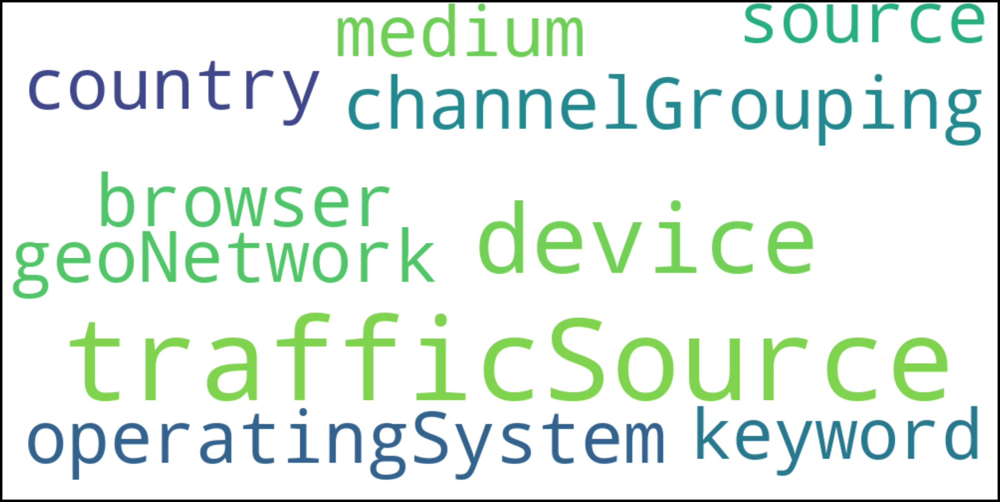

In [14]:
wordcloud(text)

### channelGrouping

In [15]:
text = " ".join(i for i in dataset['channelGrouping'].unique())
print ("There are {} unique words in the combination of all channelGrouping.".format(len(text)))

There are 76 unique words in the combination of all channelGrouping.


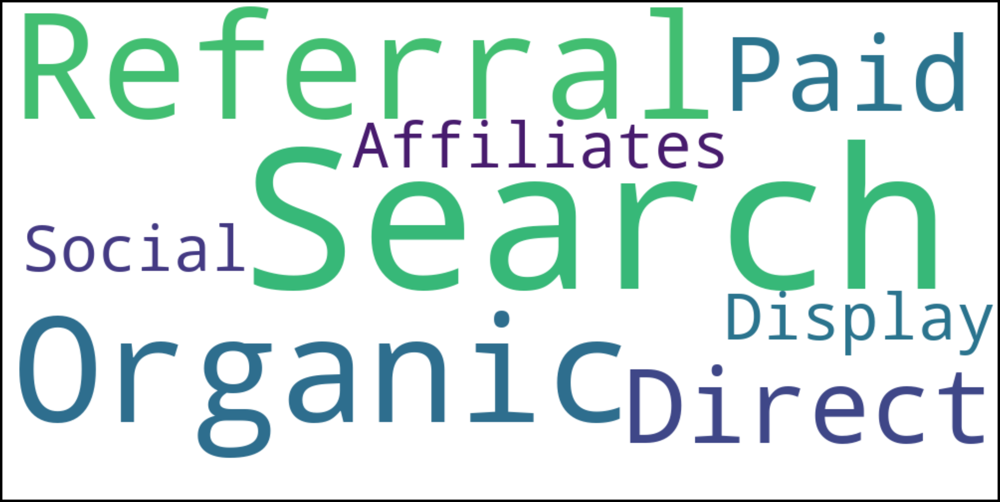

In [16]:
wordcloud(text)

### device.browser

In [17]:
text = " ".join(i for i in dataset['device.browser'].unique())
print ("There are {} unique words in the combination of all device.browser.".format(len(text)))

There are 2971 unique words in the combination of all device.browser.


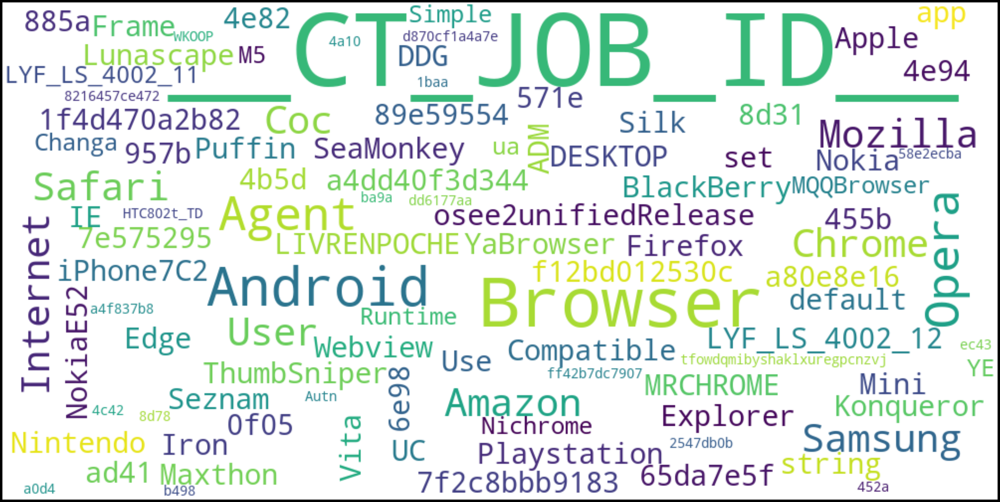

In [18]:
wordcloud(text)

### device.operatingSystem

In [19]:
text = " ".join(i for i in dataset['device.operatingSystem'].unique())
print ("There are {} unique words in the combination of all device.operatingSystem.".format(len(text)))

There are 221 unique words in the combination of all device.operatingSystem.


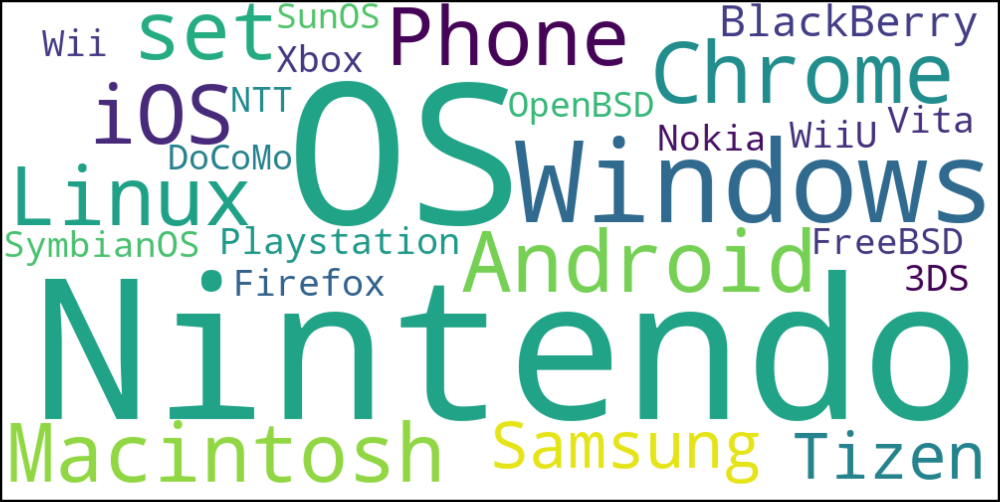

In [20]:
wordcloud(text)

### geoNetwork.country

In [21]:
text = " ".join(i for i in dataset['geoNetwork.country'].unique())
print ("There are {} unique words in the combination of all geoNetwork.country.".format(len(text)))

There are 2280 unique words in the combination of all geoNetwork.country.


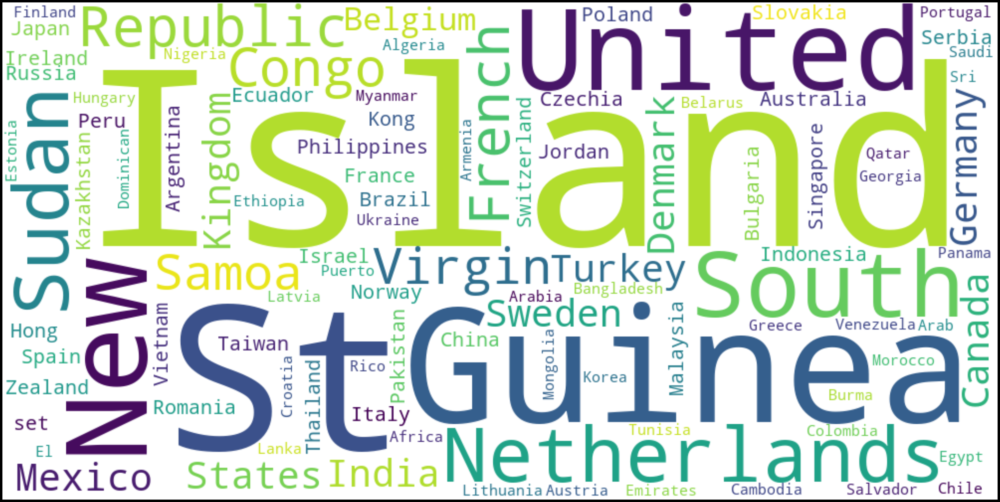

In [22]:
wordcloud(text)

### trafficSource.keyword

In [23]:
text = " ".join(i for i in dataset['trafficSource.keyword'].unique())
print ("There are {} unique words in the combination of all trafficSource.keyword.".format(len(text)))

There are 88286 unique words in the combination of all trafficSource.keyword.


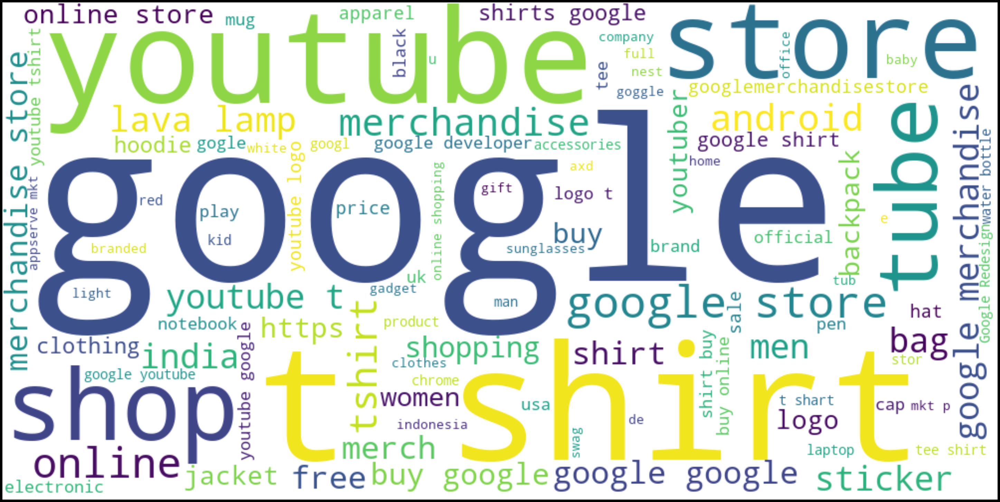

In [24]:
wordcloud(text)

### trafficSource.medium

In [25]:
text = " ".join(i for i in dataset['trafficSource.medium'].unique())
print ("There are {} unique words in the combination of all trafficSource.medium.".format(len(text)))

There are 51 unique words in the combination of all trafficSource.medium.


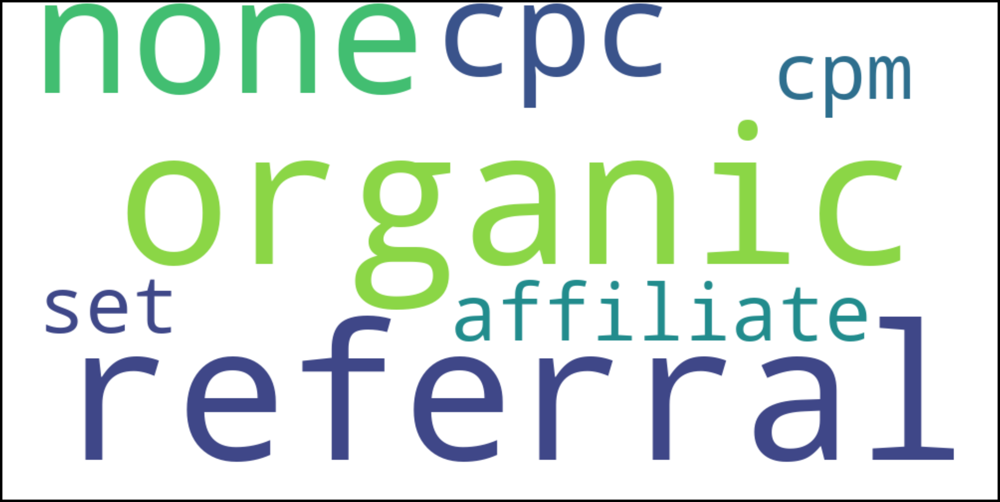

In [26]:
wordcloud(text)

### trafficSource.source

In [27]:
text = " ".join(i for i in dataset['trafficSource.source'].unique())
print ("There are {} unique words in the combination of all trafficSource.source.".format(len(text)))

There are 5523 unique words in the combination of all trafficSource.source.


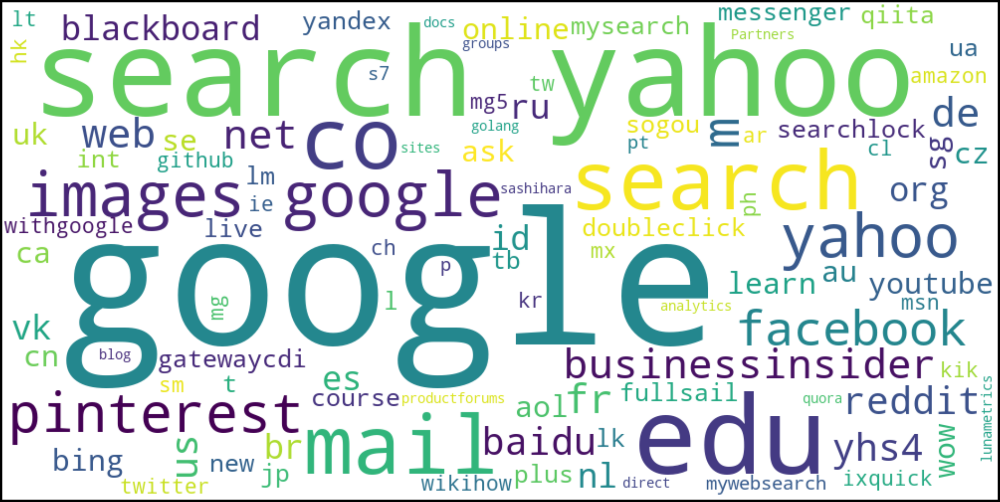

In [28]:
wordcloud(text)